# PROJET APPLICATION DE RECOMMANDATION DE FILMS

## PARTIE 1 : KPI

fiche des films   
https://www.imdb.com/title/tt1853728/?ref_=fn_al_tt_1

<img src="./images/Djangounchained.webp" width="700" height="500"/>

<!-- ![](./images/Djangounchained.webp) -->

#### **title.akas.tsv.gz** : Ce fichier contient des informations sur les différents titres d’un film ou d’une série TV dans différentes régions et langues.

- **titleId** : Identifiant unique du titre.
 
- **ordering** : Un nombre pour identifier de manière unique les lignes pour un titleId donné.
 
- **title** : Le titre localisé.
 
- **region** : La région pour cette version du titre.
 
- **language** : La langue du titre.
 
- **types** : Ensemble énuméré d’attributs pour ce titre alternatif.
 
- **attributes** : Termes supplémentaires pour décrire ce titre alternatif, non énumérés.

- **isOriginalTitle** : 0 si ce n’est pas le titre original ; 1 si c’est le titre original.
	

#### **title.basics.tsv.gz** : Ce fichier contient des informations de base sur les titres.

- **tconst** : Identifiant unique du titre.
 
- **titleType** : Le type/format du titre (par exemple, film, court métrage, série TV, épisode TV, vidéo, etc).
 
- **primaryTitle** : Le titre le plus populaire / le titre utilisé par les réalisateurs sur les supports promotionnels lors de la sortie.

- **originalTitle** : Titre original, dans la langue originale.

- **isAdult** : 0 pour un titre non adulte ; 1 pour un titre adulte.

- **startYear** : Représente l’année de sortie d’un titre. Dans le cas d’une série TV, il s’agit de l’année de début de la série.
 
- **endYear** : Année de fin de la série TV. ‘\N’ pour tous les autres types de titres.
 
- **genres** : Comprend jusqu’à trois genres associés au titre.

#### **title.crew.tsv.gz** : Ce fichier contient des informations sur l’équipe de tournage d’un titre.

- **tconst** : Identifiant unique du titre.
 
- **directors** : Réalisateur(s) du titre donné.
 
- **writers** : Scénariste(s) du titre donné.

#### **title.episode.tsv.gz** : Ce fichier contient des informations sur les épisodes d’une série TV.

- **tconst** : Identifiant de l’épisode.
 
- **parentTconst** : Identifiant de la série TV parente.
 
- **seasonNumber** : Numéro de la saison à laquelle appartient l’épisode.
 
- **episodeNumber** : Numéro de l’épisode dans la série TV.
	
#### **title.principals.tsv.gz** : Ce fichier contient des informations sur les principaux participants d’un titre.

- **tconst** : Identifiant unique du titre.
 
- **ordering** : Un nombre pour identifier de manière unique les lignes pour un titleId donné.
 
- **nconst** : Identifiant unique de la personne.
 
- **category** : La catégorie de travail dans laquelle cette personne était.
 
- **job** : Le titre spécifique du travail si applicable, sinon ‘\N’.

- **characters** : Le nom du personnage joué si applicable, sinon ‘\N’.

#### **title.ratings.tsv.gz** : Ce fichier contient des informations sur les notes d’un titre.

- **tconst** : Identifiant unique du titre.
 
- **averageRating** : Moyenne pondérée de toutes les notes des utilisateurs.
 
- *numVotes** : Nombre de votes que le titre a reçus.

#### **name.basics.tsv.gz** : Ce fichier contient des informations de base sur une personne.

- **nconst** : Identifiant unique de la personne.
 
- **primaryName** : Nom par lequel la personne est le plus souvent créditée.
 
- **birthYear** : En format YYYY.
 
- **deathYear** : En format YYYY si applicable, sinon ‘\N’.
 
- **primaryProfession** : Les 3 principales professions de la personne.
 
- **knownForTitles** : Titres pour lesquels la personne est connue.

In [1]:
import os
import io
import gzip
import random
import secrets
import datetime
import requests
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import svm
import plotly.io as pio
from sklearn import tree
import plotly.express as px
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.cluster import KMeans
from scipy.cluster import hierarchy
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score
from sklearn.metrics import silhouette_score
from sklearn.ensemble import IsolationForest
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import SGDRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import NearestNeighbors
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import classification_report
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.cluster import AgglomerativeClustering
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, r2_score
from scipy.spatial.distance import pdist, squareform
from sklearn.ensemble import HistGradientBoostingRegressor
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from flask import Flask, request, render_template, session, url_for, redirect
from sklearn.preprocessing import (
    MaxAbsScaler,
    MinMaxScaler,
    Normalizer,
    PowerTransformer,
    QuantileTransformer,
    RobustScaler,
    StandardScaler,

)
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, TargetEncoder


# Chargement des datasets de type TSV -Scrapping
les fichiers étant mis à jour quotidiennement, nous faisons le choix d'une fonction
 permetant de les importer et de les sauvegarder automatiquement

In [5]:
# scrapping des noms des fichiers
url = "https://datasets.imdbws.com/"

# contournement d'éventuels protection anti-scrapping
navigator = "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3"

response = requests.get(url, headers={"User-Agent": navigator})
# response = requests.get(url)
soup = BeautifulSoup(response.text, "html.parser")

# Trouver tous les liens sur la page
liens = soup.find_all("a")

# création de la liste des fichiers
fichiers = []
for lien in liens:
    #  choisir uniquement les liens de type href
    nom_fichier = lien.get("href")
    #  choisir uniquement les liens se terminant par .tsv.gz
    if nom_fichier.endswith(".tsv.gz"):
        # print(nom_fichier)
        fichiers.append(nom_fichier)
# print(f"\n fichiers:\n{fichiers} \n")


In [4]:
# Création du dictionnaire pour stocker les DataFrames
dfs = {}
liste_noms_df = []

for fichier in fichiers:
    # url = f'https://datasets.imdbws.com/{fichier}'
    response = requests.get(fichier)
    gzip_file = gzip.open(io.BytesIO(response.content), "rt", encoding="utf-8")
    df = pd.read_csv(gzip_file, sep="\t", low_memory=False)
    # Chaque DataFrame porte le nom du fichier sans l'extension
    nom_sans_extension = os.path.splitext(os.path.basename(fichier))[0]
    # Suppression du tz et remplacement des . par des _
    nom_sans_extension = os.path.splitext(nom_sans_extension)[
        0].replace(".", "_")
    dfs[nom_sans_extension] = df
    liste_noms_df.append(nom_sans_extension)
    print(f"\nNom du DataFrame : {nom_sans_extension}")



Nom du DataFrame : name_basics

Nom du DataFrame : title_akas

Nom du DataFrame : title_basics

Nom du DataFrame : title_crew

Nom du DataFrame : title_episode

Nom du DataFrame : title_principals

Nom du DataFrame : title_ratings


In [ ]:
# sauvegarde des datafdrames sur le disque au format csv
# for nom, df in dfs.items():
#     df.to_csv(f"data_csv/{nom}.csv", index=False)


#### sauvegarde des dataframes au format pickle et copie de chacun accessibles globalement

In [ ]:
import pandas as pd
import os
#  séparation des df de dfs
for nom_df in dfs:
    df_nom_df = dfs[nom_df].apply(pd.Series)
    # print(f"\nDataFrame :{nom_df} :\n{df_nom_df.shape}")
    # Sauvegarde du DataFrame en format pickle
    df_nom_df.to_pickle(f"data_pickle/df_{nom_df}.pkl")
    df_nom_df2 = pd.read_pickle(f"data_pickle/df_{nom_df}.pkl")

# chemin des sauvegardes des dataframe au format pickle
dossier = 'data_pickle'

# liste des fichiers dans le dossier
fichiers = os.listdir(dossier)

# on ne garde que les fichiers .pkl
fichiers_pickle = [f for f in fichiers if f.endswith('.pkl')]

# Charge chaque fichier pickle en tant que DataFrame
for fichier in fichiers_pickle:
    # suppression extension .pkl du nom du fichier pour l'utiliser comme nom de variable
    nom_df = fichier[:-4]
    # Charge le DataFrame à partir du fichier pickle
    df = pd.read_pickle(os.path.join(dossier, fichier))
    # Ajoutez le DataFrame à l'espace de noms global
    # par sécu on va travailler sur des copies des dfs
    df2 = df.copy()
    # Ajoute le DataFrame à l'espace de noms global avec le suffixe "2"
    #  Attention il ne faut pas que les noms puissent se confondre avec d'autres variables globales
    globals()[nom_df+'2'] = df2


In [ ]:
# liste des df accessibles globalement
# df_title_akas2
# df_title_basics2
# df_title_crew2
# df_title_episode2
# df_title_principals2
# df_name_basics2


### Creation d'un fichier de synthése au format md des datasets servira de base pour le choix des dataset, puis des colonnes et enfin des valeurs

In [ ]:
# # création d'un fichier de synthése des dataframes au format markdown
# import datetime

# # date et heure actuelles
# now = datetime.datetime.now()
# # Formatage date et heure au format 2024-01-01-9h30
# date_time = now.strftime("%Y-%m-%d-%Hh%M")
# # Ajouter la date et l'heure au nom du fichier
# filename = f"synthése_dataframes_{date_time}.md"
# with open(filename, "w", encoding="utf-8") as f:
#     for df in dfs:
#         your_dataframe = dfs[df]
#         f.write(f"\n## DataFrame : {df}\n")
#         f.write(f"- **Shape** : `{your_dataframe.shape}`\n")
#         f.write(
#             f"- **Liste des colonnes** : `{your_dataframe.columns.tolist()}`\n")
#         f.write(
#             f"- **Liste des colonnes numériques** : `{
#                 your_dataframe.select_dtypes(include=[np.number]).columns.tolist()}`\n"
#         )
#         f.write(
#             f"- **Liste des colonnes non numériques** : `{
#                 your_dataframe.select_dtypes(exclude=[np.number]).columns.tolist()}`\n"
#         )
#         f.write(
#             f"- **Colonnes avec des NA** :\n```\n{
#                 your_dataframe.isna().sum()}\n```\n"
#         )
#         f.write(
#             f"- **Noms des colonnes avec au moins une valeur NA** : `{
#                 your_dataframe.columns[your_dataframe.isna().any()].tolist()}`\n"
#         )
#         f.write(
#             f"- **Nombre de lignes avec au moins une valeur NA** : `{
#                 your_dataframe.isna().any(axis=1).sum()}`\n"
#         )
#         headers = " | ".join(your_dataframe.columns.tolist())
#         # Obtenir les lignes
#         rows = [" | ".join(row)
#                 for row in your_dataframe.head(2).astype(str).values]
#         # Écrire les en-têtes et les lignes dans le fichier
#         f.write(f"- **head** :\n```\n{headers}\n{'\n'.join(rows)}\n```\n")


#### Fonction principale de traitement des Datasets
filtre les colonnes, les valeurs et les valeurs \N

sauve le dataset au format pickle

Fonction de traitement global de tous les dataset en même temps

In [ ]:
import pandas as pd

# Fonction de traitement global de tous les dataframes
#  trie sur les colonnes à garder
#  trie sur les valeurs  à garder

# duree_film_min = 80
# duree_film_max = 180
# nombre_votant_min = 100
# note_moyenne_mini = 4
# annee_min = "1980"
# # liste_dataframes


def traitement_global_dataframes(liste_dataframes, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min):
    # liste des noms de dataframes filtrés
    liste_dataframes_filtered = []
    for df in liste_dataframes:
        # filtre le dataset df_title_akas
        if df == 'df_title_akas3':
            df_name = "title_akas"
            my_dataframe = df
            # liste des colonnes à filtrer et à garder aprés filtre
            # liste colonnes: ['titleId', 'ordering', 'title', 'region', 'language', 'types', 'attributes', 'isOriginalTitle']`
            # on garde que les  colonnes suivantes ['titleId', 'title', 'region', 'types']`
            col_to_filtre = ['titleId', 'region', 'title', 'types']
            col_to_keep = ['titleId', 'region', 'title', 'types']
            # tableau des valeurs à garder par colonne
            liste_valeur_to_keep = {
                'types': ['imdbDisplay'],
                'region': ["FR"]
            }
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            my_dataframe_filtered = traitement_dataframe(df_name, my_dataframe, col_to_filtre, col_to_keep,
                                                         liste_valeur_to_keep, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)
            my_dataframe_filtered = "df_title_akas3_filtered"
            liste_dataframes_filtered.append(my_dataframe_filtered)

        elif df == 'df_title_basics3':
            # initialisation des variables
            df_name = "title_basics"
            my_dataframe = df
            # liste des colonnes ['tconst', 'titleType', 'primaryTitle', 'originalTitle', 'isAdult', 'startYear', 'endYear', 'runtimeMinutes', 'genres']
            col_to_filtre = ['tconst', 'titleType', 'primaryTitle',
                             'startYear',  'runtimeMinutes', 'genres']
            col_to_keep = ['tconst', 'primaryTitle',
                           'startYear', 'runtimeMinutes', 'genres']
            # tableau des valeurs à garder par colonne
            liste_valeur_to_keep = {
                "titleType": ['movie'],
                "genres": ['Action', 'Thriller', 'Adventure', 'Sci-Fi', 'Fantasy', 'Animation', 'War', 'Family', 'Musical', 'Mystery', 'Comedy',  'Drama'],
                "startYear": [annee_min],
                "runtimeMinutes": [duree_film_min, duree_film_max]
            }
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            my_dataframe_filtered = traitement_dataframe(df_name, my_dataframe, col_to_filtre, col_to_keep,
                                                         liste_valeur_to_keep, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)
            # resultat
            my_dataframe_filtered = "df_title_basics_filtered"
            liste_dataframes_filtered.append(my_dataframe_filtered)

        elif df == 'df_title_crew3':
            # initialisation des variables
            df_name = "title.crew"
            my_dataframe = df
            # liste des colonnes ['tconst', 'directors', 'writers']
            col_to_filtre = ['tconst', 'directors']
            col_to_keep = col_to_filtre
            # tableau des valeurs à garder par colonne
            liste_valeur_to_keep = {}
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            my_dataframe_filtered = traitement_dataframe(df_name, my_dataframe, col_to_filtre, col_to_keep,
                                                         liste_valeur_to_keep, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)
            # resultat
            my_dataframe_filtered = "df_title_crew_filtered"
            liste_dataframes_filtered.append(my_dataframe_filtered)

        elif df == 'df_title_ratings3':
            # initialisation des variables
            df_name = "title_ratings"
            my_dataframe = df
            # liste des colonnes ['tconst', 'averageRating', 'numVotes']
            col_to_filtre = ['tconst', 'averageRating', 'numVotes']
            col_to_keep = ['tconst', 'averageRating', 'numVotes']
            # tableau des valeurs à garder par colonne
            liste_valeur_to_keep = {
                "averageRating": [note_moyenne_mini],
                "numVotes": [nombre_votant_min]
            }
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            my_dataframe_filtered = traitement_dataframe(df_name, my_dataframe, col_to_filtre, col_to_keep,
                                                         liste_valeur_to_keep, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)
            # resultat
            my_dataframe_filtered = "df_title_ratings_filtered"
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            liste_dataframes_filtered.append(my_dataframe_filtered)

        elif df == 'df_name_basics3':
            # initialisation des variables
            df_name = "name_basics"
            my_dataframe = df
            # liste des colonnes ['nconst', 'primaryName', 'birthYear', 'deathYear', 'primaryProfession', 'knownForTitles']
            col_to_filtre = ['nconst', 'primaryName']
            col_to_keep = ['nconst', 'primaryName']
            # tableau des valeurs à garder par colonne
            liste_valeur_to_keep = {}
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            my_dataframe_filtered = traitement_dataframe(df_name, my_dataframe, col_to_filtre, col_to_keep,
                                                         liste_valeur_to_keep, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)
            # resultat
            my_dataframe_filtered = "df_name_basics_filtered"
            liste_dataframes_filtered.append(my_dataframe_filtered)

        elif df == 'df_title_principals3':
            # initialisation des variables
            df_name = "title_principals"
            my_dataframe = df
            #  liste des colonnes['tconst', 'ordering', 'nconst', 'category', 'job', 'characters']
            col_to_filtre = ["tconst", "nconst", "category"]
            col_to_keep = ["tconst", "nconst", "category"]
            # tableau des valeurs à garder par colonne
            liste_valeur_to_keep = {
                'category': ['self', 'director', 'producer', 'composer'
                             'editor', 'actor', 'actress', 'writer'],
            }
            # fonction de traitement des colonnes et des valeurs d'un dataframe
            my_dataframe_filtered = traitement_dataframe(df_name, my_dataframe, col_to_filtre, col_to_keep,
                                                         liste_valeur_to_keep, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)
            # resultat
            my_dataframe_filtered = "df_title_principals_filtered"
            liste_dataframes_filtered.append(my_dataframe_filtered)

    return my_dataframe_filtered

# fonction de traitement des colonnes et des valeurs d'un dataframe


def traitement_dataframe(nom_dataframe, my_dataframe, colonne_a_filtrer, colonne_a_garder, liste_valeur_a_garder):
    try:
        # On ne garde que les colonnes spécifiées
        my_dataframe = my_dataframe[colonne_a_filtrer]
    except KeyError:
        print("Erreur : Une ou plusieurs colonnes spécifiées ne sont pas présentes dans le DataFrame.")
        return

    # Si liste_valeur_a_garder est vide, on ne fait rien
    if liste_valeur_a_garder:

        for col in liste_valeur_a_garder:
            try:
                # Si la colonne est 'startYear', on ne garde que les films à partir de l'an 2000
                if col == "startYear":
                    my_dataframe[col] = pd.to_numeric(
                        my_dataframe[col], errors='coerce')
                    my_dataframe = my_dataframe[my_dataframe[col] >= int(
                        liste_valeur_a_garder[col][0])]

                # Si la colonne est 'runtimeMinutes', on ne garde que les films dont la durée est entre 120 et 180 minutes
                elif col == "runtimeMinutes":
                    my_dataframe[col] = pd.to_numeric(
                        my_dataframe[col], errors='coerce')
                    my_dataframe = my_dataframe[(my_dataframe[col] >= int(liste_valeur_a_garder[col][0])) & (
                        my_dataframe[col] <= int(liste_valeur_a_garder[col][1]))]

                # filtre les notes
                elif col == "averageRating":
                    # Convertissez les colonnes 'averageRating' et 'numVotes' en nombres
                    my_dataframe[col] = pd.to_numeric(
                        my_dataframe[col], errors='coerce')
                    # Gardez uniquement les lignes où 'averageRating' est supérieur à 8
                    my_dataframe = my_dataframe[(
                        my_dataframe[col] > liste_valeur_a_garder[col][0])]
                 # filtre le nombres de votant
                elif col == 'numVotes':
                    # Convertissez les colonnes 'averageRating' et 'numVotes' en nombres
                    my_dataframe[col] = pd.to_numeric(
                        my_dataframe[col], errors='coerce')
                    # Gardez uniquement les lignes où 'numVotes' est supérieur ou égal à 200
                    my_dataframe = my_dataframe[my_dataframe[col]
                                                >= liste_valeur_a_garder[col][0]]

                # Pour les autres colonnes, on ne garde que les valeurs spécifiées
                else:
                    filtre_to_keep = liste_valeur_a_garder[col]
                    filtre_type_category = my_dataframe[col].isin(
                        filtre_to_keep)
                    my_dataframe = my_dataframe[filtre_type_category]
                pass

            except KeyError:
                print(f"Erreur : La colonne '{
                      col}' n'est pas présente dans le DataFrame.")
                return
            except TypeError:
                print(f"Erreur : Les valeurs pour la colonne '{
                      col}' ne peuvent pas être converties en nombre.")
                return

    try:
        # Après le traitement, on ne garde que les colonnes finales spécifiées
        print(f"\ncolonne_a_garder :\n{colonne_a_garder} \n")
        my_dataframe = my_dataframe[colonne_a_garder]
    except KeyError:
        print("Erreur : Une ou plusieurs colonnes finales spécifiées ne sont pas présentes dans le DataFrame.")
        return
    # Suppression des \N des colonnes restantes
    # my_dataframe = my_dataframe.loc[:, ~(my_dataframe == r'\N').any()]
    my_dataframe = my_dataframe.replace(r'\N', pd.NA)
    my_dataframe = my_dataframe.dropna()

    # Sauvegarde du DataFrame dans le dossier data_filtered
    my_dataframe.to_pickle(f"data_filtered/df_{nom_dataframe}_filtered.pkl")

    # Retourne le DataFrame traité
    return my_dataframe


ZOZO

In [ ]:
duree_film_min = 80
duree_film_max = 180
nombre_votant_min = 100
note_moyenne_mini = 4
annee_min = "1980"
# liste_dataframes

traitement_global_dataframes(liste_dataframes, duree_film_min, duree_film_max, nombre_votant_min, note_moyenne_mini, annee_min)


In [ ]:
liste_dataframes


# Echantillonnage des DATASET

## traitement title_akas

#### **title.akas.tsv.gz** : Ce fichier contient des informations sur les différents titres d’un film ou d’une série TV dans différentes régions et langues.

- **titleId** : Identifiant unique du titre.
 
- **ordering** : Un nombre pour identifier de manière unique les lignes pour un titleId donné.
 
- **title** : Le titre localisé.
 
- **region** : La région pour cette version du titre.
 
- **language** : La langue du titre.
 
- **types** : Ensemble énuméré d’attributs pour ce titre alternatif.
 
- **attributes** : Termes supplémentaires pour décrire ce titre alternatif, non énumérés.

- **isOriginalTitle** : 0 si ce n’est pas le titre original ; 1 si c’est le titre original.

_Plutot que de supprimer des colonnes il est preferable de garder celles qui nous interessent car  les BDD du site imdb sont mises à jour quotidiennement et peuvent changer de type ou de nom_

## traitement title_principals

#### **title.principals.tsv.gz** : Ce fichier contient des informations sur les principaux participants d’un titre.

- **tconst** : Identifiant unique du titre.
 
- **ordering** : Un nombre pour identifier de manière unique les lignes pour un titleId donné.
 
- **nconst** : Identifiant unique de la personne.
 
- **category** : La catégorie de travail dans laquelle cette personne était.
 
- **job** : Le titre spécifique du travail si applicable, sinon ‘\N’.

- **characters** : Le nom du personnage joué si applicable, sinon ‘\N’.

##### traitement de la colonne category

###### liste des categories uniques

-**self** :  faire référence à un film ou à une émission de télévision où les acteurs jouent leur propre rôle.

-**director** : Le réalisateur est la personne qui supervise la production artistique et dramatique d’un film, et qui en dirige le tournage.

-**cinematographer** : Le directeur de la photographie est la personne qui est en charge de la prise de vue, de l’éclairage et de la composition visuelle du film.

-**composer** : Le compositeur crée la musique originale du film.

-**producer** : Le producteur supervise tous les aspects de la production d’un film, de la conception à la distribution.

-**editor** : L’éditeur assemble les images filmées pour créer le produit final.

-**actor** : Un acteur joue un personnage dans un film.

-**actress** : Une actrice joue un personnage dans un film.

-**writer** : Le scénariste écrit le scénario du film.

-**production_designer** : Le chef décorateur est responsable de la conception visuelle globale du film.

-**archive_footage** :  fait référence à un film qui utilise des images d’archives.

-**archive_sound** : fait référence à un film qui utilise des sons d’archives.

### traitement title.basics

#### traitement title.basics  : Ce fichier contient des informations de base sur les titres.

- **tconst** : Identifiant unique du titre.
 
- **titleType** : Le type/format du titre (par exemple, film, court métrage, série TV, épisode TV, vidéo, etc).
 
- **primaryTitle** : Le titre le plus populaire / le titre utilisé par les réalisateurs sur les supports promotionnels lors de la sortie.

- **originalTitle** : Titre original, dans la langue originale.

- **isAdult** : 0 pour un titre non adulte ; 1 pour un titre adulte.

- **startYear** : Représente l’année de sortie d’un titre. Dans le cas d’une série TV, il s’agit de l’année de début de la série.
 
- **endYear** : Année de fin de la série TV. ‘\N’ pour tous les autres types de titres.
 
- **genres** : Comprend jusqu’à trois genres associés au titre.


### Traitement title.crew
##### **title.crew.tsv.gz** : Ce fichier contient des informations sur l’équipe de tournage d’un titre.

- **tconst** : Identifiant unique du titre.
 
- **directors** : Réalisateur(s) du titre donné.
 
- **writers** : Scénariste(s) du titre donné.

### traitement ratings
#### **title.ratings.tsv.gz** : Ce fichier contient des informations sur les notes d’un titre.

- **tconst** : Identifiant unique du titre.
 
- **averageRating** : Moyenne pondérée de toutes les notes des utilisateurs.
 
- **numVotes** : Nombre de votes que le titre a reçus.

## Traitement de basics

#### **name.basics.tsv.gz** : Ce fichier contient des informations de base sur une personne.

- **nconst** : Identifiant unique de la personne.
 
- **primaryName** : Nom par lequel la personne est le plus souvent créditée.
 
- **birthYear** : En format YYYY.
 
- **deathYear** : En format YYYY si applicable, sinon ‘\N’.
 
- **primaryProfession** : Les 3 principales professions de la personne.
 
- **knownForTitles** : Titres pour lesquels la personne est connue.

## Fusion des dataset

Fonction globale de merge des dataset en un seul du nom de merged_df

In [14]:
# Merge des dataset en un  seul du nom de merged_df
def merge_dataset_filtered():

    # le dataset qui va filtre les autres au niveau nombre de film est title_rating

    merged_df = pd.merge(df_title_ratings_filtered,
                         df_title_basics_filtered, on='tconst', how='inner')

    print(f"shape title_ratings et title_basics_filtered  :{merged_df.shape} ")

    # merge title_principals_filtered

    merged_df = pd.merge(merged_df, df_title_principals_filtered,
                         on='tconst', how='inner')

    print(f"shape title_principals :{merged_df.shape} ")

    df_title_akas_filtered

    # Merge avec title_akas pour avoir les films en francais et l'indices des acteurs

    merged_df = pd.merge(merged_df, df_title_akas_filtered,
                         left_on='tconst', right_on='titleId', how='inner')

    print(f"shape title_akas :{merged_df.shape} ")

    # Merge avec name_basic popur avoir des infos sur le casting
    merged_df = pd.merge(merged_df, df_name_basics_filtered,
                         on='nconst',  how='inner')
    print(f"shape name_basic :{merged_df.shape} ")
    return merged_df


merged_df = merge_dataset_filtered()
merged_df


shape title_ratings et title_basics_filtered  :(20033, 7) 
shape title_principals :(152260, 9) 
shape title_akas :(39098, 13) 
shape name_basic :(39098, 14) 


,tconst,averageRating,numVotes,primaryTitle,startYear,runtimeMinutes,genres,nconst,category,titleId,title,types,region,primaryName
0,tt0062181,6.5,416,Hands Up!,1981.0,80.0,Drama,nm0804592,actor,tt0062181,Haut les mains!,imdbDisplay,FR,Jerzy Skolimowski
1,tt0104252,5.6,396,30 Door Key,1991.0,90.0,Drama,nm0804592,director,tt0104252,Ferdydurke,imdbDisplay,FR,Jerzy Skolimowski
2,tt19652910,6.7,13479,EO,2022.0,88.0,Drama,nm0804592,director,tt19652910,EO,imdbDisplay,FR,Jerzy Skolimowski
3,tt0062181,6.5,416,Hands Up!,1981.0,80.0,Drama,nm0843848,actress,tt0062181,Haut les mains!,imdbDisplay,FR,Joanna Szczerbic
4,tt0062181,6.5,416,Hands Up!,1981.0,80.0,Drama,nm0518591,actor,tt0062181,Haut les mains!,imdbDisplay,FR,Tadeusz Lomnicki
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39093,tt9902160,7.0,4612,Herself,2020.0,97.0,Drama,nm2988542,actor,tt9902160,Herself,imdbDisplay,FR,Ian Lloyd Anderson
39094,tt9902160,7.0,4612,Herself,2020.0,97.0,Drama,nm1630273,director,tt9902160,Herself,imdbDisplay,FR,Phyllida Lloyd
39095,tt9902160,7.0,4612,Herself,2020.0,97.0,Drama,nm0132696,writer,tt9902160,Herself,imdbDisplay,FR,Malcolm Campbell
39096,tt9902160,7.0,4612,Herself,2020.0,97.0,Drama,nm1279721,producer,tt9902160,Herself,imdbDisplay,FR,Sharon Horgan


sauvergarde du dataframe au format pickle et csv

In [ ]:
# sauvegarde de la base fusionnée
# Sauvegarde du DataFrame dans le dossier data_filtered un double est fait pour le projet django
def save_df_merged(df):
    nom_fichier_merged = "merged"
    try:
        # Essayer de sauvegarder le dataframe en format pickle
        df.to_pickle(f"data_merged/df_{nom_fichier_merged}.pkl")
        # pour django
        df.to_pickle(f"Django/data_merged/df_{nom_fichier_merged}.pkl")
    except Exception as e:
        print(
            "Une erreur s'est produite lors de la sauvegarde du dataframe en format pickle.")
        print(str(e))

    try:
        # Essayer de sauvegarder le dataframe en format csv
        df.to_csv(
            # pour django
            f"Django/data_merged/df_{nom_fichier_merged}.csv", index=False)
        df.to_csv(f"data_merged/df_{nom_fichier_merged}.csv", index=False)
    except Exception as e:
        print("Une erreur s'est produite lors de la sauvegarde du dataframe en format csv.")
        print(str(e))

    return df


merged_df
save_df_merged(merged_df)
merged_df


### Si les etapes de création et de sauvegardes des dataset sont faites on peut juste charger  merged_df

#### chargement de merge_df

In [15]:
# AAA
def chargement_merged_filtered():
    # Pour eviter de refaire les datasets on peut recharger la sauvegarde de merged_df
    with open('data_merged/df_merged.pkl', 'rb') as file:
        merged_df = pickle.load(file)
        file.close()
    return merged_df


#### chargement des dataset filtrés au format pickle

In [4]:
def chargement_df_filtered(dossier):
    # liste des fichiers dans le dossier
    liste_noms_df_filtered = os.listdir(dossier)
    # print(f"\n :\n{liste_noms_df_filtered} \n")
    # liste_noms_df_filtered: ['df_name_basics_filtered.pkl', 'df_title.crew_filtered.pkl', 'df_title_akas_filtered.pkl', 'df_title_basics_filtered.pkl', 'df_title_principals_filtered.pkl', 'df_title_ratings_filtered.pkl']

    for dataset in liste_noms_df_filtered:
        print(f"chargement dataset :{dossier+'/'+dataset} ")
        with open(dossier+'/'+dataset, 'rb') as file:
            # Créer une variable avec le nom du fichier sans l'extension .pkl
            var_name = dataset.replace(".pkl", "")
            # Assigner le contenu du fichier pickle à la variable
            globals()[var_name] = pickle.load(file)
            file.close()
    return


In [17]:
# AAA
# chargment de merged_df
merged_df = chargement_merged_filtered()
# chemin des sauvegardes des dataframe au format pickle
dossier = 'data_filtered'
chargement_df_filtered(dossier)


chargement dataset :data_filtered/df_name_basics_filtered.pkl 


chargement dataset :data_filtered/df_title.crew_filtered.pkl 
chargement dataset :data_filtered/df_title_akas_filtered.pkl 
chargement dataset :data_filtered/df_title_basics_filtered.pkl 
chargement dataset :data_filtered/df_title_principals_filtered.pkl 
chargement dataset :data_filtered/df_title_ratings_filtered.pkl 


In [18]:
nombre_de_films = merged_df["tconst"].nunique()
print(f"\nnombre_de_films :\n{nombre_de_films} \n")



nombre_de_films :
4953 



In [356]:
# Résumé des informations du dataframe
your_dataframe = merged_df
print("#"+"-"*79)
print("valeurs uniques des colonnes:")
for col in your_dataframe.columns:
    #    print("#"+"#"*20)
    print(f"====colonne====: {col} \n====nb valeur uniques====:{
          your_dataframe[col].nunique()} ")
    if your_dataframe[col].nunique() < 15:
        print(r", ".join(
            f"'{item}'" for item in your_dataframe[col].unique().tolist()))
    else:
        unique_values = your_dataframe[col].unique()[:15]
        print("====15 premiers====: \n" +
              ", ".join(f"'{item}'" for item in unique_values))
print("#"+"-"*79)
print(f"\n====shape====: {your_dataframe.shape} \n====list columns==== :\n{
      your_dataframe.columns.tolist()} ")
# print("#"+"#"*20)
print(f"====liste des colonnes numeriques====: \n{
      your_dataframe.select_dtypes(include=[np.number]).columns.tolist()}\n")
# print("#"+"#"*20)
print(f"====liste des colonnes non numeriques====: \n{
      your_dataframe.select_dtypes(exclude=[np.number]).columns.tolist()} ")
# print("#"+"#"*20)
print(f"====Noms des colonnes avec au moins une valeur NA==== : {
      your_dataframe.columns[your_dataframe.isna().any()].tolist()}")
# print("#"+"#"*20)
print(f"====Nombre de lignes avec au moins une valeur NA==== : {
      your_dataframe.isna().any(axis=1).sum()}")
# print("#"+"#"*20)
print(f"====Colonne avec des na==== :{your_dataframe.isna().sum()} \n")


#-------------------------------------------------------------------------------
valeurs uniques des colonnes:
====colonne====: tconst 
====nb valeur uniques====:4953 
====15 premiers====: 
'tt0062181', 'tt0104252', 'tt19652910', 'tt0069049', 'tt0092843', 'tt0115675', 'tt0105017', 'tt0088939', 'tt6744360', 'tt0075816', 'tt0091097', 'tt0104799', 'tt0089019', 'tt21149522', 'tt0079765'
====colonne====: averageRating 
====nb valeur uniques====:52 
====15 premiers====: 
'6.5', '5.6', '6.7', '7.2', '5.3', '7.4', '7.7', '5.1', '4.5', '4.9', '5.4', '5.9', '4.6', '4.8', '6.6'
====colonne====: numVotes 
====nb valeur uniques====:2453 
====15 premiers====: 
'416', '396', '13479', '7928', '8744', '832', '12079', '94539', '1196', '223', '394', '253', '365', '1592', '327'
====colonne====: primaryTitle 
====nb valeur uniques====:4883 
====15 premiers====: 
'Hands Up!', '30 Door Key', 'EO', 'The Other Side of the Wind', 'The Dead', 'The Big Brass Ring', 'Noises Off...', 'The Color Purple', 'Lost Trans

### KPI des DataFrames, possibilités :

1. **name_basics** : Nombre total d'acteurs, nombre d'acteurs par profession, nombre d'acteurs nés chaque année...
2. **title_akas** : Nombre total de titres, nombre de titres par région ou par langue...
3. **title_basics** : Nombre total de titres par type (film, série, etc.), durée moyenne des titres, nombre de titres par genre...
4. **title_crew** : Nombre de réalisateurs et scénaristes uniques, nombre moyen de réalisateurs et scénaristes par titre...
5. **title_episode** : Nombre total d'épisodes, nombre moyen d'épisodes par saison...
6. **title_principals** : Nombre moyen de personnages par titre, nombre de titres par acteur...
7. **title_ratings** : Note moyenne des titres, nombre moyen de votes par titre...

##### KPI dans le dataframe df_merge

In [42]:
# Importer la bibliothèque fuzzywuzzy
from fuzzywuzzy import fuzz

# Définir la variable acteur
acteur = 'lermite'  # Remplacez 'lermite' par le nom de l'acteur que vous recherchez

# Définir le seuil de similarité
seuil = 66  # Remplacez 80 par le seuil de similarité que vous voulez

# Filtrer le dataframe
df['lastName'] = df['primaryName'].str.split().str[-1]
lastNames_uniques = df['lastName'].unique()
df_acteur = df[df['lastName'].apply(
    lambda x: fuzz.ratio(x, acteur) > 66)]
# df_acteur
# df_acteur['primaryName'].value_counts().idxmax()
df_acteur['primaryName'].mode()[0]


'Thierry Lhermitte'

In [43]:
# Importer la bibliothèque fuzzywuzzy
from fuzzywuzzy import fuzz


def get_top_seuil_fuzzi(df, acteur):
    # Définir la variable acteur
    # acteur = 'lermite'  # Remplacez 'lermite' par le nom de l'acteur que vous recherchez

    # Initialiser le meilleur seuil et le meilleur nombre de noms
    meilleur_seuil = 0
    meilleur_nb_noms = float('inf')

    # Tester différents seuils de similarité
    for seuil in range(100, 0, -1):
        # Filtrer le dataframe
        df['lastName'] = df['primaryName'].str.split().str[-1]
        df_acteur = df[df['lastName'].apply(
            lambda x: fuzz.ratio(x, acteur) > seuil)]

        # Calculer le nombre de noms différents
        nb_noms = df_acteur['lastName'].nunique()

        # Vérifier si le nombre de noms est entre 4 et 20
        if nb_noms < 30 and nb_noms > 5:
            # Mettre à jour le meilleur seuil et le meilleur nombre de noms
            meilleur_seuil = seuil
            meilleur_nb_noms = nb_noms

            # Arrêter la boucle
            break

    # Afficher le meilleur seuil et le meilleur nombre de noms
    print('Meilleur seuil :', meilleur_seuil)
    print('Meilleur nombre de noms :', meilleur_nb_noms)
    return df_acteur['primaryName'].mode()[0]


df = merged_df
actor_name_test = 'lermite'
name_actor = get_top_seuil_fuzzi(df, actor_name_test
                                 )


Meilleur seuil : 66
Meilleur nombre de noms : 8


In [52]:
# name_actor
df_acteur.columns.tolist()
print(f"\n :\n{df_acteur.columns.tolist()} \n")



 :
['tconst', 'averageRating', 'numVotes', 'primaryTitle', 'startYear', 'runtimeMinutes', 'genres', 'nconst', 'category', 'titleId', 'title', 'types', 'region', 'primaryName', 'lastName'] 



In [130]:
# Importer la bibliothèque fuzzywuzzy ou l'installer !pip install fuzzywuzzy
from fuzzywuzzy import fuzz


def stat_acteur(df1, acteur):
    df = df1.copy()
    try:
        # Filtrer le dataframe
        df['lastName'] = df['primaryName'].str.split().str[-1]
        # lastNames_uniques = df['lastName'].unique()
        df_acteur = df[df['lastName'].apply(
            lambda x: fuzz.ratio(x, acteur) > 66)]
        # df_acteur['primaryName'].mode()[0]
    except Exception as e:
        print(
            "Une erreur s'est produite lors de la recherche de l'acteur dans le dataframe.")

        print(str(e))
        pass
    try:
        print(f"\nListe de tous les acteurs dont le nom ressemble à celui que vous avez saisi :\n{
              df_acteur['primaryName'].unique().tolist()} \n")
    except Exception as e:

        print("Une erreur s'est produite lors de la création de la liste des acteurs.")


        print(str(e))
        pass
    try:
        nom_le_plus_frequent = df_acteur['primaryName'].mode()[0]

        print("Le nom le plus courament utilisé est :", nom_le_plus_frequent)
        df_acteur = df[df['primaryName'] == nom_le_plus_frequent]
    except Exception as e:
        print("Une erreur s'est produite lors de la recherche du nom le plus fréquent.")

        print(str(e))
        pass
    try:
        nombre_films = df_acteur.shape[0]
        premiere_annee = df_acteur['startYear'].min()
    except Exception as e:
        print("Une erreur s'est produite lors du calcul du nombre de films et de l'année du premier film.")

        print(str(e))
        pass
    films_info = None  # Définir une valeur par défaut
    try:
        df_acteur['startYear'] = df_acteur['startYear'].astype(int)
        films_info = df_acteur[['startYear', 'title', 'primaryName',
                                'genres', 'runtimeMinutes', 'averageRating', 'numVotes']].copy()
    except Exception as e:
        print("Une erreur s'est produite lors de la création de la liste d'informations sur les films.")

        print(str(e))
        pass
    try:
        note_moyenne = df_acteur['averageRating'].mean()
    except Exception as e:
        print("Une erreur s'est produite lors du calcul de la note moyenne.")
        print(str(e))


        pass
    top_3_films = None  # Définir une valeur par défaut
    try:
        # Les 3 films de l'acteur qui ont eu le plus de succès
        top_3_films = df_acteur.sort_values(by='averageRating', ascending=False).head(3)[
            ['title', 'startYear', 'averageRating', 'numVotes']]
    except Exception as e:
        print(
            "Une erreur s'est produite lors de la recherche des 3 films les plus réussis.")

        print(str(e))
        pass
    print(f"Depuis {premiere_annee:.0f}, {
          nom_le_plus_frequent} a participé à {nombre_films} films.")
    # print(f"Informations sur le casting des films :{
    #       films_info['casting'] if films_info is not None else 'Non
    print(f"La note moyenne de tous ses films est {note_moyenne:.2f}")
    print(f"\nLes 3 films de l'acteur qui ont eu le plus de succès sont :\n{
          top_3_films if top_3_films is not None else 'Non disponible'}")
    # print(f"Informations sur les films :{films_info}")
# ['tconst', 'averageRating', 'numVotes', 'primaryTitle', 'startYear', 'runtimeMinutes', 'genres', 'nconst', 'category', 'titleId', 'title', 'types', 'region', 'primaryName', 'lastName']
    df_statistique_acteur = pd.DataFrame()
    try:
        df_statistique_acteur = pd.DataFrame({
            # 'Acteur': [nom_le_plus_frequent],
            'Titre': [df_acteur['title'].iloc[0]],
            # 'Année du film': [df_acteur['startYear'].iloc[0]],
            # 'Category': [df_acteur['category'].iloc[0]],
            # 'Genre': [df_acteur['genres'].iloc[0]],
            # 'Note moyenne': [df_acteur['averageRating'].iloc[0]],
            # 'Durée': [df_acteur['runtimeMinutes'].iloc[0]],
        })
    except Exception as e:
        print("Une erreur s'est produite lors de la création du dataframe df_stat_acteur.")
        print(str(e))
        pass
    else:
        df_statistique_acteur = pd.DataFrame({
            'Acteur': [acteur],
            # 'Top 3 films':top_3_films,
            # 'Titre': df_acteur['title'],
            # 'Année du film':df_acteur['startYear'],
            # 'Category':df_acteur['category'],
            # 'Genre':df_acteur['genres'],
            # 'Note moyenne': df_acteur['averageRating'],
            # 'Durée': df_acteur['runtimeMinutes'],
        })
        pass
    # return
    # Afficher le dataframe avec un formatage approprié
    # display(df_stat_acteur.to_markdown())

    return df_statistique_acteur


In [111]:
def get_casting(film, df):
    casting_roles = ('producer', 'director', 'actor', 'actress', 'compositeur')
    df_casting = df[(df['title'] == film) & (
        df['category'].isin(casting_roles))]

    casting_dict = {}
    for role in casting_roles:
        names = df_casting[df_casting['category'] == role]
        casting_dict[role] = names.iloc[0] if not names.empty else 'Inconnu'

    return casting_dict


In [131]:
df_statistique_acteur = stat_acteur(merged_df, "lermite")



Liste de tous les acteurs dont le nom ressemble à celui que vous avez saisi :
['Thierry Lhermitte', 'Marine Delterme', 'Selim Ileri', 'Luiza Leite', 'Richard Armitage', 'José Leite', 'Nicolas Lhermitte', 'Carlee Malemute', 'Gelmine Glemzaite', 'Maha Alemi'] 

Le nom le plus courament utilisé est : Thierry Lhermitte
Depuis 1981, Thierry Lhermitte a participé à 24 films.
La note moyenne de tous ses films est 5.70

Les 3 films de l'acteur qui ont eu le plus de succès sont :
                             title  startYear  averageRating  numVotes
979               Le dîner de cons       1998            7.6     43821
972  Le Père Noël est une ordure !       1982            7.5     10324
982                     Le placard       2001            7.0     18204


C:\Users\romar\AppData\Local\Temp\ipykernel_4852\2280683020.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_acteur['startYear'] = df_acteur['startYear'].astype(int)


In [280]:
# !!! le tableau des stat ne fonctionne pas !!!
print(f"df_stat_acteur :{df_statistique_acteur} ")


df_stat_acteur :    Acteur
0  lermite 


In [133]:
import pandas as pd

# Pour le DataFrame name_basics

def analyse_name_basics(df):
    # Nombre total d'acteurs
    # total_acteurs = df[df['category'].isin(['actor', 'actress'])].shape[0]
    total_acteurs = df.shape[0]
    # Nombre d'acteurs par profession
    # acteurs_par_profession = df['category'].value_counts()
    # Nombre d'acteurs nés chaque année
    # acteurs_par_annee = df['birthYear'].value_counts()

    return total_acteurs

# Pour le DataFrame title_akas


def analyse_title_akas(df):
    # Nombre total de titres
    total_titres = df['titleId'].nunique()
    # Nombre de titres par région
    titres_par_region = df['region'].value_counts()
    # Nombre de titres par langue
    # titres_par_langue = df['language'].value_counts()

    return total_titres, titres_par_region

# Pour le DataFrame title_basics


def analyse_title_basics(df):
    # Nombre total de titres par type
    # total_titres_par_type = df['titleType'].value_counts()
    # Durée moyenne des titres
    duree_moyenne = df['runtimeMinutes'].mean()
    # Nombre de titres par genre
    titres_par_genre = df['genres'].value_counts()

    return duree_moyenne, titres_par_genre

# Pour le DataFrame title_crew


def analyse_title_crew(df):
    # Nombre de réalisateurs et scénaristes uniques
    total_realisateurs = df['directors'].nunique()
    # total_scenaristes = df['writers'].nunique()
    # Nombre moyen de réalisateurs et scénaristes par titre
    moyenne_realisateurs_par_titre = df.groupby(
        'tconst')['directors'].nunique().mean()
    # moyenne_scenaristes_par_titre = df.groupby('tconst')['writers'].nunique().mean()

    return total_realisateurs,  moyenne_realisateurs_par_titre

# # Pour le DataFrame title_episode
# def analyse_title_episode(df):
#     # Nombre total d'épisodes
#     total_episodes = df.shape[0]
#     # Nombre moyen d'épisodes par saison
#     moyenne_episodes_par_saison = df.groupby('seasonNumber').size().mean()

#     return total_episodes, moyenne_episodes_par_saison

# Pour le DataFrame title_principals


def analyse_title_principals(df):
    # Nombre moyen de personnages par titre
    moyenne_personnages_par_titre = df.groupby('tconst').size().mean()
    # Nombre de titres par acteur
    titres_par_acteur = df[df['category'].isin(
        ['actor', 'actress'])]['nconst'].value_counts()

    return moyenne_personnages_par_titre, titres_par_acteur

# Pour le DataFrame title_ratings


def analyse_title_ratings(df):
    # Note moyenne des titres
    note_moyenne = df['averageRating'].mean()
    # Nombre moyen de votes par titre
    moyenne_votes_par_titre = df['numVotes'].mean()

    return note_moyenne, moyenne_votes_par_titre


In [ ]:
note_moyenne, moyenne_votes_par_titre = analyse_title_ratings(
    df_title_ratings_filtered)
print(f"\nnote_moyenne :{note_moyenne:.2f} \n")
print(f"\nmoyenne_votes_par_titre:{moyenne_votes_par_titre:.2f} \n")

moyenne_personnages_par_titre, titres_par_acteur = analyse_title_principals(
    df_title_principals_filtered)
print(f"\nmoyenne_personnages_par_titre :{
      moyenne_personnages_par_titre:.2f} \n")
print(f"\ntitres_par_acteur :\n{titres_par_acteur} \n")

total_realisateurs, moyenne_realisateurs_par_titre = analyse_title_crew(
    df_title_crew_filtered)
print(f"\ntotal_realisateurs :\n{total_realisateurs} \n")
print(f"\nmoyenne_realisateurs_par_titre :\n{
      moyenne_realisateurs_par_titre:.2f} \n")
# print(f"\nmoyenne_scenaristes_par_titre :\n{moyenne_scenaristes_par_titre} \n")

duree_moyenne, titres_par_genre = analyse_title_basics(
    df_title_basics_filtered)
# print(f"\ntotal_titres_par_type :\n{total_titres_par_type} \n")
print(f"\nduree_moyenne :\n{duree_moyenne:.2f} \n")
print(f"\ntitres_par_genre :\n{titres_par_genre} \n")

total_acteurs = analyse_name_basics(df_name_basics_filtered)
print(f"\ntotal_acteurs :\n{total_acteurs} \n")
# print(f"\nacteurs_par_profession :\n{acteurs_par_profession} \n")
# print(f"\nacteurs_par_annee :\n{acteurs_par_annee} \n")

total_titres, titres_par_region = analyse_title_akas(df_title_akas_filtered)
print(f"\ntotal_titres :\n{total_titres} \n")
print(f"\ntitres_par_region :\n{titres_par_region} \n")
# print(f"\ntitres_par_langue :\n{titres_par_langue} \n")


#### Gestion d'un projet de machine learning
1. **EDA :**
    - Analyse descriptive des données : stats (tendance centrale, forme (kurtosis, skewness)...), nettoyage, valeurs manquantes (fillna, dropna, isna..), outliers (boxplot, écart interquartile, z-score).
    - Analyse exploratoire : corrélation linéaire (quanti-quanti), Chi2 (quali-quali), ANOVA (quanti-quali), heatmap, pairplot.
    - Tests statistiques : normalité, homoscédasticité, colinéarité, stationnarité, analyse de la p-value...
2. **Preprocessing :**
    - Encodage : dummies, one-hot...
    - Standardisation : min_max, centrage-réduction...
    - Réduction de dimension : ACP et analyse du cercle de corrélation.
3. **Les pré-requis des modèles à utiliser.**
4. **Modélisation :**
    - Choix d'une liste de modèles qu'on classe par complexité (du moins au plus).
    - Grid search.
- faire un knn avec les 15 plus proches voisins
    - Train_test valid split avec KFold (pour vérifier l'impact de la distribution des splits sur les résultats).
    - Choix des métriques d'évaluation des modèles.
    - Clustering sur les données pour un score plus adapté.
    - Pipeline pour automatiser les étapes précédentes.
5. **Monitoring du modèle :** évaluation au cours du temps de l'amélioration ou de la dégradation des performances, et potentiel changement de modèle.


# Prevision 

aprés avoir fait la phase de precprocessing, notre dataframe est propre et filtré avec les données qui nous interessent nous pouvons ,passer à la coneption du modele previsionniste

##### Suppression des colonnes inutiles de merge_df

In [19]:
# BBBB
# Suppression des colonnes inutiles de merge_df
def get_merged_df2_with_good_col(merged_df):
    merged_df2 = merged_df.copy()
    # on retire la colonne titleId car c'est la meme que tconst
    merged_df2.drop("titleId", axis=1, inplace=True)
    # on retire la colonne region  car tout est en francais
    merged_df2.drop("region", axis=1, inplace=True)
    # on retire la colonne types  car on a 1 seul type
    merged_df2.drop("types", axis=1, inplace=True)
    # on retire la colonne primaryTitle  car on a  déja la colonne titre
    merged_df2.drop("primaryTitle", axis=1, inplace=True)
    # on retire la colonne nconst  car on a  déja la colonne primaryName pour les noms
    merged_df2.drop("nconst", axis=1, inplace=True)
    # on retire la colonne tconst  car on a  déja la colonne title pour les noms
    # merged_df2.drop("tconst", axis=1, inplace=True)
    return merged_df2
merged_df2 = get_merged_df2_with_good_col(merged_df)


Choix entre Standardisation ou Normalisation des colonnes numériques

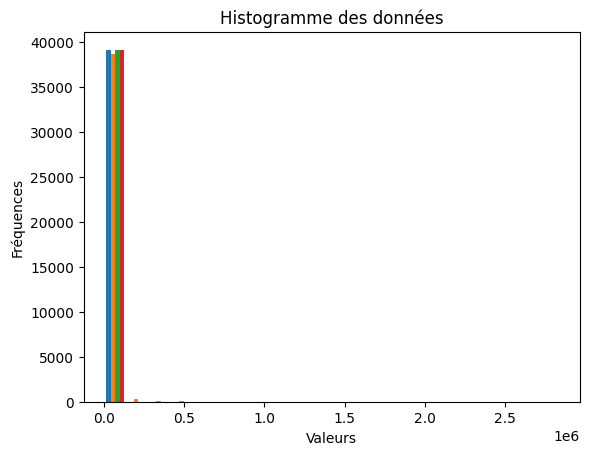

In [360]:
# approche grahique pour voir si les répartition est de type normale ou non
# Importer la bibliothèque matplotlib
import matplotlib.pyplot as plt

liste_colonnes_numeriques
data = merged_df2[liste_colonnes_numeriques].values
# Tracer un histogramme
plt.hist(data, bins=20)
plt.title('Histogramme des données')
plt.xlabel('Valeurs')
plt.ylabel('Fréquences')
plt.show()


les 4 colonnes numériques ont des échelles et des distributions similaires, on peut donc utiliser la standardisation ou la normalisation indifféremment. Les deux techniques vont rendre les données plus homogènes et comparables, sans changer leur forme. La différence sera que la standardisation va conserver la moyenne et l’écart-type de vos données, tandis que la normalisation va les ramener entre 0 et 11.

La standardisation ou la normalisation peut améliorer la qualité de l’ACP ou des algorithmes d’apprentissage automatique, en évitant les problèmes d’échelle ou de valeurs extrêmes.

In [21]:
merged_df2


,tconst,averageRating,numVotes,startYear,runtimeMinutes,genres,category,title,primaryName
0,tt0062181,6.5,416,1981.0,80.0,Drama,actor,Haut les mains!,Jerzy Skolimowski
1,tt0104252,5.6,396,1991.0,90.0,Drama,director,Ferdydurke,Jerzy Skolimowski
2,tt19652910,6.7,13479,2022.0,88.0,Drama,director,EO,Jerzy Skolimowski
3,tt0062181,6.5,416,1981.0,80.0,Drama,actress,Haut les mains!,Joanna Szczerbic
4,tt0062181,6.5,416,1981.0,80.0,Drama,actor,Haut les mains!,Tadeusz Lomnicki
...,...,...,...,...,...,...,...,...,...
39093,tt9902160,7.0,4612,2020.0,97.0,Drama,actor,Herself,Ian Lloyd Anderson
39094,tt9902160,7.0,4612,2020.0,97.0,Drama,director,Herself,Phyllida Lloyd
39095,tt9902160,7.0,4612,2020.0,97.0,Drama,writer,Herself,Malcolm Campbell
39096,tt9902160,7.0,4612,2020.0,97.0,Drama,producer,Herself,Sharon Horgan


In [139]:
# Nous faisons le choix d'une normalisation des colonnes numeriques suivant la méthode des minmaxscaler

# Créer un objet MinMaxScaler
scaler = MinMaxScaler()
# # Normaliser les colonnes numériques en utilisant la méthode fit_transform de l'objet scaler

merged_df2[liste_colonnes_numeriques] = scaler.fit_transform(
    merged_df2[liste_colonnes_numeriques])




Optimisation des colonnes catégorielles du dataframe avec HashingVectorizer qui semble bien convenir quand on a autant de valeurs disctintes

tendance centrale, forme kurtosis, skewness

identifier les outliers

In [295]:
# Importer la bibliothèque plotly.express
import plotly.express as px

# Tracer un px.box avec les données du dataframe merged_df2
fig = px.box(data_frame=merged_df2, x='category',
             y='averageRating', color='title', points='outliers')

# Afficher le graphique
fig.show()


In [32]:
import plotly.express as px
# créer un diagramme en boîte pour les colonnes averageRating et numVotes

fig = px.box(merged_df2, y=["title"])


# afficher le graphique

fig.show()


In [176]:
import plotly.express as px
fig = px.imshow(
    merged_df2[["averageRating", "startYear", "runtimeMinutes", "numVotes"]])
# fig = px.imshow(merged_df2)
fig.show()


In [177]:
import plotly.express as px
fig = px.scatter_matrix(merged_df2, dimensions=[
                        "averageRating", "numVotes", "startYear", "runtimeMinutes"])
fig.show()


In [24]:
# Calculer les quartiles de chaque colonne numérique
Q1 = merged_df2.quantile(0.25, numeric_only=True)
Q3 = merged_df2.quantile(0.75, numeric_only=True)
print(f"\nQ1 :\n{Q1} \n")
print(f"\nQ3 :\n{Q3} \n")
# Calculer l'écart interquartile de chaque colonne numérique
IQR = Q3 - Q1
print(f"\nIQR :\n{IQR} \n")

# Définir les limites inférieure et supérieure pour détecter les outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
print(f"\nlower_bound :\n{lower_bound} \n")
print(f"\nupper_bound :\n{upper_bound} \n")

# Filtrer les outliers de chaque colonne numérique
# outliers = merged_df2[(merged_df2 < lower_bound) | (merged_df2 > upper_bound)]
# print(f"\noutliers :\n{outliers} \n")

# Q1 :
# averageRating     0.269231
# numVotes          0.000060
# startYear         0.534884
# runtimeMinutes    0.101010
# Name: 0.25, dtype: float64


# Q3 :
# averageRating     0.500000
# numVotes          0.000721
# startYear         0.906977
# runtimeMinutes    0.272727
# Name: 0.75, dtype: float64


# IQR :
# averageRating     0.230769
# numVotes          0.000661
# startYear         0.372093
# runtimeMinutes    0.171717
# dtype: float64


# lower_bound :
# averageRating    -0.076923
# numVotes         -0.000931
# startYear        -0.023256
# runtimeMinutes   -0.156566
# dtype: float64


# upper_bound :
# averageRating     0.846154
# numVotes          0.001713
# startYear         1.465116
# runtimeMinutes    0.530303
# dtype: float64




Q1 :
averageRating        5.5
numVotes           271.0
startYear         2003.0
runtimeMinutes      90.0
Name: 0.25, dtype: float64 


Q3 :
averageRating        6.7
numVotes          2148.0
startYear         2019.0
runtimeMinutes     107.0
Name: 0.75, dtype: float64 


IQR :
averageRating        1.2
numVotes          1877.0
startYear           16.0
runtimeMinutes      17.0
dtype: float64 


lower_bound :
averageRating        3.7
numVotes         -2544.5
startYear         1979.0
runtimeMinutes      64.5
dtype: float64 


upper_bound :
averageRating        8.5
numVotes          4963.5
startYear         2043.0
runtimeMinutes     132.5
dtype: float64 



In [ ]:
from scipy.stats import zscore
# Calculer le z-score de chaque valeur de chaque colonne numérique
z_scores = merged_df2.apply(zscore)
print(f"z_scores :\n{z_scores} \n")

# Définir le seuil pour détecter les outliers
threshold = 3

# Filtrer les outliers de chaque colonne numérique
# outliers = merged_df2[(z_scores.abs() > threshold).any(axis=1)]


calculer corrélation linéaire (quanti-quanti), Chi2 (quali-quali), ANOVA (quanti-quali), heatmap, pairplot.

Tests statistiques : 
			normalité, 
			homoscédasticité, 
			colinéarité, 
			stationnarité, 
			analyse de la p-value

Comme nous sommes en modele non supervisé il faut employer la recherche des  voisins les plus proches avec NearestNeighbors et non KNeighborsClassifier

Modele  NearestNeighbors

Choix du nombre de voisin k et du metrique (str ou callable, default='minkowski')

Choix de K et du metrique

In [166]:
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import GridSearchCV

y = merged_df2['title']
liste_moyennes = {}
for k in range(8, 15):
    model = NearestNeighbors(n_neighbors=k)
    model.fit(X)
    # Obtenir les distances et les indices des k voisins les plus proches de chaque point
    distances, indices = model.kneighbors(X)

    # Calculer la moyenne des distances pour chaque point
    mean_distances = distances.mean(axis=1)

    # Ajouter la moyenne des distances à la liste des moyennes
    liste_moyennes[k] = mean_distances.mean()

# Initialiser min_distance à une valeur très élevée
min_distance = float('inf')
best_k = None

# Parcourir les moyennes des distances pour chaque k
for k, mean_distance in liste_moyennes.items():
    # Si la moyenne des distances pour ce k est plus petite que min_distance
    if mean_distance < min_distance:
        # Mettre à jour min_distance et best_k
        min_distance = mean_distance
        best_k = k

# Afficher le meilleur k et la plus petite moyenne des distances
print(f"Best k: {best_k}, min mean_distances: {min_distance:.2f}")

# Best k: 8, min mean_distances: 0.56
# wrapper autour de NearestNeighbors qui implémente une méthode score.  définition de la  classe KNNWithScore qui hérite de NearestNeighbors et ajoute une méthode score. Cette méthode renvoie la moyenne des distances aux k voisins les plus proches, ce qui est similaire à ce que vous avez fait pour trouver le meilleur k


class KNNWithScore(NearestNeighbors):
    def score(self, X, y=None):
        distances, _ = self.kneighbors(X)
        return -distances.mean()


# Créer le modèle
model = KNNWithScore()

# Définir les paramètres à optimiser
param_grid = {
    'n_neighbors': [best_k],  # best_k est une liste ici
    'metric': ['euclidean', 'manhattan', 'minkowski']
}

# Créer la recherche sur gridsearch
grid = GridSearchCV(model, param_grid)

# Ajuster la recherche sur gridsearch aux données
grid.fit(X, y)

# Afficher les meilleurs paramètres
print(grid.best_params_)
# {'metric': 'euclidean', 'n_neighbors': 8}


Best k: 8, min mean_distances: 0.56


Notre fonction nous donne 'metric': 'euclidean' et  'n_neighbors': 8

In [196]:
# Créer le graphique avec plotly
fig = px.scatter(merged_df2, x="averageRating", y="numVotes",
                 color="cluster", hover_name="title", hover_data=["primaryName", "runtimeMinutes"])
fig.update_layout(title="Visualisation des clusters avec plotly",
                  xaxis_title="Note moyenne", yaxis_title="Nombre de votes")
fig.show()


In [ ]:
liste_film = merged_df2["title"].unique().tolist()
liste_film


In [ ]:
# 'Haut les mains!', 'Ferdydurke', 'EO', "De l'autre côté du vent", 'Gens de Dublin', 'Les rênes du pouvoir', 'Bruits de coulisses', 'La couleur pourpre',
#  'Lost Transmissions', 'Rosa', "L'enchaîné", 'Malicia 2000', 'Attention... Privés!', 'Notre très chère famille', 'Mon curé va en boîte'


# on repart à zero en mettant au  propre pour tester d'autres paramétres ACP 

In [26]:
# on repart à zero en mettant au  propre pour tester d'autres paramétres ACP  RAZ
merged_df2 = get_merged_df2_with_good_col(merged_df)

# merged_df2.drop("lastName", axis=1, inplace=True)
merged_df2


,tconst,averageRating,numVotes,startYear,runtimeMinutes,genres,category,title,primaryName
0,tt0062181,6.5,416,1981.0,80.0,Drama,actor,Haut les mains!,Jerzy Skolimowski
1,tt0104252,5.6,396,1991.0,90.0,Drama,director,Ferdydurke,Jerzy Skolimowski
2,tt19652910,6.7,13479,2022.0,88.0,Drama,director,EO,Jerzy Skolimowski
3,tt0062181,6.5,416,1981.0,80.0,Drama,actress,Haut les mains!,Joanna Szczerbic
4,tt0062181,6.5,416,1981.0,80.0,Drama,actor,Haut les mains!,Tadeusz Lomnicki
...,...,...,...,...,...,...,...,...,...
39093,tt9902160,7.0,4612,2020.0,97.0,Drama,actor,Herself,Ian Lloyd Anderson
39094,tt9902160,7.0,4612,2020.0,97.0,Drama,director,Herself,Phyllida Lloyd
39095,tt9902160,7.0,4612,2020.0,97.0,Drama,writer,Herself,Malcolm Campbell
39096,tt9902160,7.0,4612,2020.0,97.0,Drama,producer,Herself,Sharon Horgan


In [14]:
# fonction donnant la liste des colonnes numeriques et non numeriques
def liste_colonne_df(df):
    # liste des colonnes numériques
    liste_colonnes_numeriques = df.select_dtypes(
        include=[np.number]).columns.tolist()
    # print(f"liste_colonnes_numeriques :{liste_colonnes_numeriques}")
    # liste des colonnes non numériques
    liste_colonnes_non_numeriques = df.select_dtypes(
        exclude=[np.number]).columns.tolist()
    # print(f"liste_colonnes_non_numeriques :{liste_colonnes_non_numeriques}")
    # print(f"\nmerged_df2.dtypes :\n{df.dtypes} \n")
    return liste_colonnes_numeriques, liste_colonnes_non_numeriques


['averageRating', 'numVotes', 'startYear', 'runtimeMinutes']

Text(0, 0.5, 'Cout du modele(inertia)')

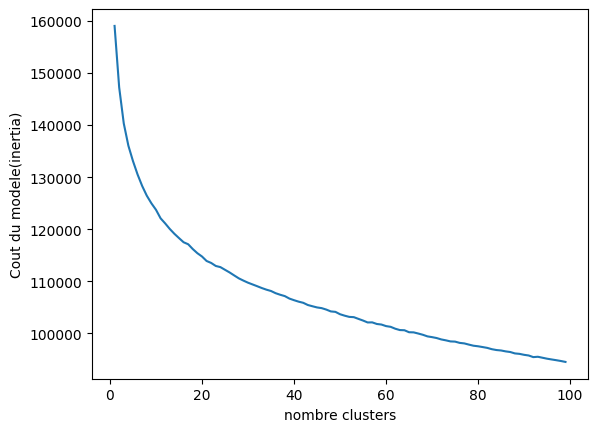

In [97]:
# calcul du nombre de cluster idéal avec le coude
inertia=[]
k_range=range(1,100)
for k in k_range:
    model = KMeans(n_clusters=k, max_iter=300, init='k-means++', n_init=10).fit(X)
    inertia.append(model.inertia_)
plt.plot(k_range, inertia)
plt.xlabel('nombre clusters')
plt.ylabel('Cout du modele(inertia)')


coefficient de silhouette

In [104]:
# pour trouver le nombre de cluster on peut aussi utiliser le coefficient de silhouette
from sklearn.metrics import silhouette_score

for k in range(11, 20):
    kmeans = KMeans(n_clusters=k, n_init=10)
    kmeans.fit(X)
    score = silhouette_score(X, kmeans.labels_)
    print(f"Pour n_clusters = {k}, le score de silhouette est de {score}")
# Pour n_clusters = 2, le score de silhouette est de 0.08232027537289172
# Pour n_clusters = 3, le score de silhouette est de 0.0660372181093903
# Pour n_clusters = 4, le score de silhouette est de 0.056566980883509
# Pour n_clusters = 5, le score de silhouette est de 0.055065522686722754
# Pour n_clusters = 6, le score de silhouette est de 0.0559266813103526
# Pour n_clusters = 7, le score de silhouette est de 0.05957607024292004
# Pour n_clusters = 8, le score de silhouette est de 0.05732227435420341
# Pour n_clusters = 9, le score de silhouette est de 0.05170432094606612
# Pour n_clusters = 10, le score de silhouette est de 0.05306519699336476
# Pour n_clusters = 11, le score de silhouette est de 0.05741663840060297
# Pour n_clusters = 12, le score de silhouette est de 0.053301931189014426
# Pour n_clusters = 13, le score de silhouette est de 0.0554016824260388
# Pour n_clusters = 14, le score de silhouette est de 0.05535829930246516
# Pour n_clusters = 15, le score de silhouette est de 0.052911195315041445
# Pour n_clusters = 16, le score de silhouette est de 0.05134907786844188
# Pour n_clusters = 17, le score de silhouette est de 0.047813831619533745
# Pour n_clusters = 18, le score de silhouette est de 0.05114420286097186
# Pour n_clusters = 19, le score de silhouette est de 0.05442176588247388


# ici le meilleur k=2 car on a le plus petit score


Pour n_clusters = 11, le score de silhouette est de 0.05741663840060297
Pour n_clusters = 12, le score de silhouette est de 0.053301931189014426
Pour n_clusters = 13, le score de silhouette est de 0.0554016824260388
Pour n_clusters = 14, le score de silhouette est de 0.05535829930246516
Pour n_clusters = 15, le score de silhouette est de 0.052911195315041445
Pour n_clusters = 16, le score de silhouette est de 0.05134907786844188
Pour n_clusters = 17, le score de silhouette est de 0.047813831619533745
Pour n_clusters = 18, le score de silhouette est de 0.05114420286097186
Pour n_clusters = 19, le score de silhouette est de 0.05442176588247388


detection d'anomalie avec isolation Forest

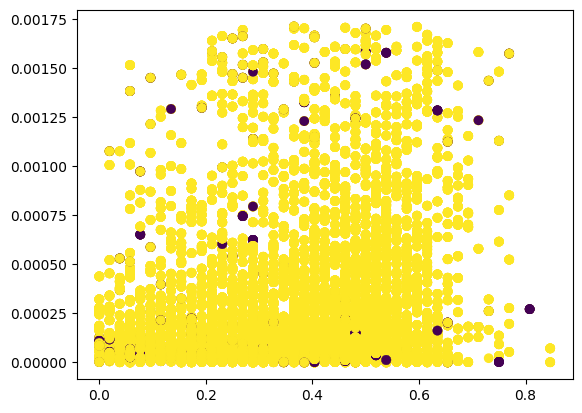

In [107]:
from sklearn.ensemble import IsolationForest
# estimation à 1% d'anomaile de notre modele
model_IF=IsolationForest(contamination=0.01)
model_IF.fit(X)
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=model_IF.predict(X))
# plt.scatter(model.cluster_centers_[:, 0],
            # model.cluster_centers_[:, 1], c='r')

# toutes les anomalies sont =-1 dans model_IF.predict(X)
outliers = model_IF.predict(X) == -1
X[outliers]
y = merged_df3['title']
# X.iloc[:, 0], X.iloc[:, 1], c = model_IF.predict(X)
plt.scatter(X[outliers].iloc[:, 0],
            X[outliers].iloc[:, 1], c='r')
# pour visualiser les 5 premiers film outliers
titles = merged_df3['title'].iloc[:5]
title_str = ', '.join(titles)
plt.title(title_str)
# plt.title(y[outliers])

# suppression des outliers
# Inverser le masque des outliers
non_outliers = ~outliers

# Utiliser le masque pour sélectionner seulement les non-outliers
merged_df3 = merged_df3[non_outliers]


 Critère d’information bayésien (BIC)


In [106]:
from sklearn.mixture import GaussianMixture

bic_list = []
best_bic = None
best_k = None

for k in range(2, 20):
    gmm = GaussianMixture(n_components=k, random_state=42)
    gmm.fit(X)
    bic = gmm.bic(X)
    bic_list.append(bic)

    print(f"Pour n_components = {k}, le BIC est de {bic}")

    if best_bic is None or bic < best_bic:
        best_bic = bic
        best_k = k

print(f"\nLe BIC le plus petit est {best_bic} pour n_components = {best_k}")
# Le BIC le plus petit est -1880251.8467128354 pour n_components = 14


Pour n_components = 2, le BIC est de -624645.1098048795
Pour n_components = 3, le BIC est de -849277.4902121187
Pour n_components = 4, le BIC est de -1062811.0843460374
Pour n_components = 5, le BIC est de -1258405.5308902077
Pour n_components = 6, le BIC est de -908121.0227259193
Pour n_components = 7, le BIC est de -1162100.2385060329
Pour n_components = 8, le BIC est de -1496959.0839556635
Pour n_components = 9, le BIC est de -1336003.1233082078
Pour n_components = 10, le BIC est de -1389437.917079162
Pour n_components = 11, le BIC est de -1585603.876336999
Pour n_components = 12, le BIC est de -1716363.5437316832
Pour n_components = 13, le BIC est de -1788668.5389336543
Pour n_components = 14, le BIC est de -1880251.8467128354
Pour n_components = 15, le BIC est de -1866425.2078216434
Pour n_components = 16, le BIC est de -1839430.9621566168
Pour n_components = 17, le BIC est de -1760711.7253220095
Pour n_components = 18, le BIC est de -1709874.4132606427
Pour n_components = 19, le 

##### Réduction de la dimension avec l'ACP
comme on fait de la classification on va choisir le nombre de composantes pour garder 95 à 99% de nos données
!! il faut d'abord standardiser avec une variance =1 les données avant de faire du PCA

(32527, 26)
(38707,)


(32527, 2)


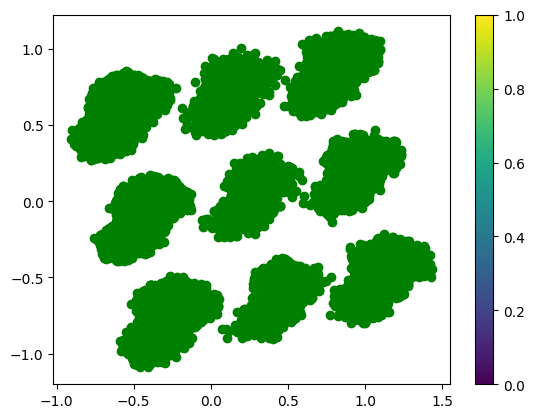

In [98]:
from sklearn.decomposition import PCA
# visualisation des données pour les projet en 2d
X.shape
print(X.shape)
print(y.shape)
y = merged_df3['title']
pca=PCA(n_components=2)
X_reduced=pca.fit_transform(X)
print(pca.fit_transform(X).shape)
plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c='g')
plt.colorbar()


In [220]:
def liste_colonne_df(df):
# liste des colonnes numériques
    liste_colonnes_numeriques = df.select_dtypes(
        include=[np.number]).columns.tolist()
    # print(f"liste_colonnes_numeriques :{liste_colonnes_numeriques}")
    # liste des colonnes non numériques
    liste_colonnes_non_numeriques = df.select_dtypes(
        exclude=[np.number]).columns.tolist()
    # print(f"liste_colonnes_non_numeriques :{liste_colonnes_non_numeriques}")
    # print(f"\nmerged_df2.dtypes :\n{df.dtypes} \n")
    return liste_colonnes_numeriques, liste_colonnes_non_numeriques


# liste_colonne_df(merged_df3)


#### Preparation des données

Création d'un DataFrame séparé contenant les tconst et les fims qui maintiendra une correspondance entre les index des films dans votre ensemble de données transformé et leurs noms originaux

Préparation des données : Vous commencez par préparer vos données. Vous normalisez vos colonnes numériques à l’aide de MinMaxScaler pour les mettre à l’échelle entre 0 et 1. Ensuite, vous utilisez BinaryEncoder pour encoder vos colonnes non numériques en format binaire. Cela transforme vos données catégorielles en une forme que les algorithmes de machine learning peuvent comprendre.

Clustering K-means : Vous utilisez l’algorithme K-means pour regrouper vos données en 14 clusters. L’algorithme K-means fonctionne en attribuant chaque point de données au centroïde le plus proche, puis en déplaçant le centroïde à la moyenne de tous les points du cluster. Vous répétez ce processus jusqu’à ce que l’inertie (la somme des distances au carré de chaque point de données à son centroïde le plus proche) soit minimisée.

Suppression des outliers avec Isolation Forest : Vous utilisez ensuite l’algorithme Isolation Forest pour détecter et supprimer les outliers de vos données. Isolation Forest fonctionne en isolant les observations en sélectionnant aléatoirement une caractéristique, puis en sélectionnant aléatoirement une valeur de division entre les valeurs maximale et minimale de la caractéristique sélectionnée. Les outliers sont les points de données qui peuvent être isolés avec moins de divisions, donc ils ont des scores d’anomalie plus élevés.

Réduction de dimension avec PCA : Enfin, vous utilisez l’Analyse en Composantes Principales (PCA) pour réduire la dimensionnalité de vos données tout en conservant 98% de la variance. Cela vous permet de visualiser vos données en deux ou trois dimensions, ou de les utiliser dans des algorithmes de machine learning qui fonctionnent mieux avec moins de dimensions.

In [159]:
# NORMALISATION OPTIMISATION DU DATASET 2éme Methode
from sklearn.ensemble import IsolationForest
import category_encoders as ce

# merged_df2 = merged_df.copy()
merged_df3 = merged_df2.copy()
liste_colonnes_numeriques, liste_colonnes_non_numeriques=liste_colonne_df(
    merged_df3)

# Créer un objet MinMaxScaler
scaler = MinMaxScaler()
# # Normaliser les colonnes numériques en utilisant la méthode fit_transform de l'objet scaler
merged_df3[liste_colonnes_numeriques] = scaler.fit_transform(
    merged_df3[liste_colonnes_numeriques])

# Binary Encoding : Cette méthode est un compromis entre One-Hot et Label Encoding. Elle convertit les entiers de l’encodage de label en binaire, puis divise les chiffres binaires en colonnes séparées. Cela peut être efficace pour les colonnes catégorielles avec de nombreuses catégories uniques

# Binary Encoding
encoder = ce.BinaryEncoder(cols=liste_colonnes_non_numeriques)
df_binary = encoder.fit_transform(merged_df3)

# Use df_binary for KMeans clustering
X = df_binary
# X = df_binary.drop('title', axis=1, inplace=False)
# on ne prend pas de  y en non supervisé
# y = merged_df3['title']

# K-means clustering
#  on affecte les pts au centroide le plus proche
# deplacement du centre à la moyenne du cluster
# excecution plrs fois pour avoir l'inertia le plus petit (=distance/au cluster)
model_knn = KMeans(n_clusters=14, max_iter=300, init='k-means++', n_init=10)
model_knn.fit(X)

# fonction cout inertia model.inertia est équivalent à model.score(X) mais en négatif, l'unité est celle du df
model_knn.inertia_
model_knn.score(X)
print(f"model.inertia_ :{model_knn.inertia_} ")
print(f"model.score(X) :{model_knn.score(X)} ")

# Suppression des outliers  avec la methode IsolationfOREST
# estimation à 1% d'anomaile de notre modele
model_IF = IsolationForest(contamination=0.01)
model_IF.fit(X)
print(f"model_IF isolationForest :{model_IF.fit(X)}")
# toutes les anomalies sont =-1 dans model_IF.predict(X)
outliers = model_IF.predict(X) == -1

# suppression des outliers
# Inverser le masque des outliers
non_outliers = ~outliers

# Utiliser le masque pour sélectionner seulement les non-outliers
merged_df3 = merged_df3[non_outliers]

# # !!!!réinitialisation des index
# df.reset_index(inplace=True, drop=True)

# Reduction de dimension en gardant 98% de notre dataset
acp = PCA(n_components=0.98)
X_reduced = acp.fit_transform(X)
# supression des outliers sur X_reduced pour avoir les memes dimensions que merged_df
X_reduced = X_reduced[non_outliers]

# print(f"model.knn.score(X_reduced) :{model_knn.score(X_reduced)}")
print(f"X :{X.shape} ")
print(f"X_reduced :{X_reduced.shape} ")
print(f"merged_df3.shape :{ merged_df3.shape} ")
print(f"nombre de composants ACP :{acp.n_components_} ")
print(f"nombre de clusters :{model_knn.n_clusters}")
# print(f"corrdonées des clusters :{model_knn.cluster_centers_}")


liste_colonnes_numeriques :['averageRating', 'numVotes', 'startYear', 'runtimeMinutes']
liste_colonnes_non_numeriques :['tconst', 'genres', 'category', 'title', 'primaryName']

merged_df2.dtypes :
tconst             object
averageRating     float64
numVotes            int64
startYear         float64
runtimeMinutes    float64
genres             object
category           object
title              object
primaryName        object
dtype: object 

model.inertia_ :355656.77965583233 
model.score(X) :-355656.77965583233 
model_IF isolationForest :IsolationForest(contamination=0.01)
X :(39098, 52) 
X_reduced :(38707, 38) 
merged_df3.shape :(38707, 9) 
nombre de composants ACP :38 
nombre de clusters :14


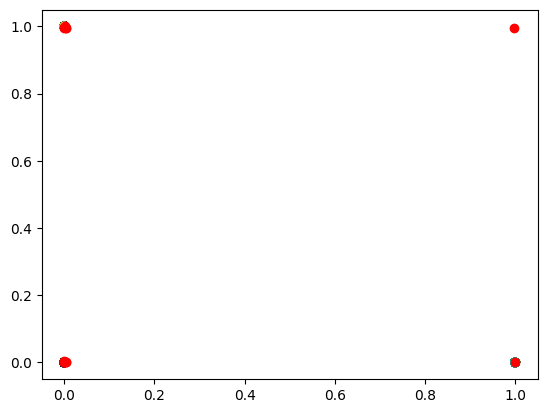

In [170]:
#GRAPHES
# Predict the labels
# labels = model_knn.predict(X)
labels = model_knn.predict(X)
    # model.cluster_centers_
# plt.scatter(X_reduced[0], X_reduced[1], c=labels)
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels)
    # graphes des centroides
plt.scatter(model_knn.fit(X).cluster_centers_[:, 0],
            model_knn.fit(X).cluster_centers_[:, 1], c='r')


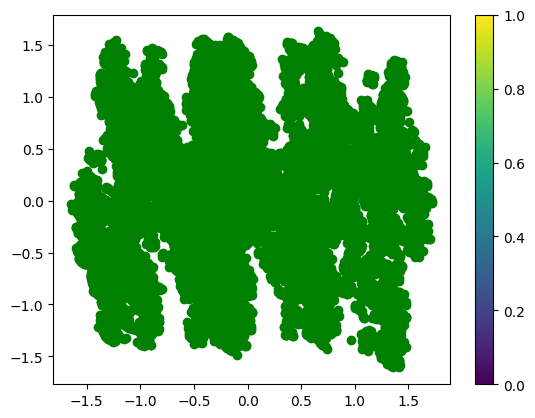

In [173]:
# GRAPHES
    # ACP
# plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels)

plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c='g')
plt.colorbar()


In [153]:
merged_df3


,tconst,averageRating,numVotes,startYear,runtimeMinutes,genres,category,title,primaryName
0,tt0062181,0.461538,0.000111,0.023256,0.000000,Drama,actor,Haut les mains!,Jerzy Skolimowski
1,tt0104252,0.288462,0.000104,0.255814,0.101010,Drama,director,Ferdydurke,Jerzy Skolimowski
2,tt19652910,0.500000,0.004712,0.976744,0.080808,Drama,director,EO,Jerzy Skolimowski
3,tt0062181,0.461538,0.000111,0.023256,0.000000,Drama,actress,Haut les mains!,Joanna Szczerbic
4,tt0062181,0.461538,0.000111,0.023256,0.000000,Drama,actor,Haut les mains!,Tadeusz Lomnicki
...,...,...,...,...,...,...,...,...,...
39093,tt9902160,0.557692,0.001589,0.930233,0.171717,Drama,actor,Herself,Ian Lloyd Anderson
39094,tt9902160,0.557692,0.001589,0.930233,0.171717,Drama,director,Herself,Phyllida Lloyd
39095,tt9902160,0.557692,0.001589,0.930233,0.171717,Drama,writer,Herself,Malcolm Campbell
39096,tt9902160,0.557692,0.001589,0.930233,0.171717,Drama,producer,Herself,Sharon Horgan


In [174]:
X.index[0]


0

In [177]:
X_reduced[0]


array([ 0.96956062, -0.06477519, -0.23990219, -0.09520029, -1.06795277,
       -0.28813227,  1.03430063,  0.04963706, -0.61709192,  0.12237089,
       -0.74384634, -0.9206716 ,  0.49321765, -0.68356392, -0.20954516,
       -0.4559601 , -0.39173582, -0.47607383,  0.42334951,  0.32006781,
       -0.5398151 ,  0.53874886, -0.40500193,  0.57904626,  0.10201238,
        0.68940004,  0.08888991, -0.56171778,  0.07305625, -0.20537144,
       -0.70288432,  0.7489227 , -0.09806358,  0.34527073, -0.01067662,
       -0.29762991, -0.05406962,  0.00115804])

### fonction de prediction des données

In [ ]:
# lancement prediction_film
df = merged_df3
nom_film = 'Le dîner de cons'
# nom_film = 'Le placard'
# nom_film = 'Herself'
# nom_film = 'Ferdydurke'
liste_noms_film = ['Le dîner de cons', 'EO', 'Le médecin imaginaire','Le placard', 'Herself', 'Ferdydurke', "Ma femme s'appelle reviens"]
# nom_film = 'Le placard'
nom_film = nom_film.strip().lower()
liste_des_films = prediction_film(df, X_reduced, nom_film)
liste_des_films


In [146]:
from sklearn.neighbors import NearestNeighbors

def prediction_film(df, X_reduced, nom_film):
    nom_film = nom_film.strip().lower()
    if not df['title'].str.contains(nom_film, case=False,  na=False).any():
        print(f"Le film '{nom_film}' n'est pas trouvé dans le dataframe.")
        return
# ----------------------------------------------------------------
    df[df["title"] == nom_film]["tconst"].iloc[0:2]

    tcons_film = df[df["title"] == nom_film]["tconst"].unique()
    print(f"\tcons_film :{tcons_film} \n")
    casting = df[df["title"] == nom_film]["primaryName"].values.tolist()
    # liste_acteurs = df[df["tconst"] == tcons_film]["primaryName"].values.tolist()
    print(f"casting :{casting} \n")
    categories = df[df["title"] == nom_film]["category"].values.tolist()
    print(f"\nproducteur :{categories} \n")

    # actrices = []
    acteurs = []
    realisateur = []
    for i in range(len(casting)):
        if categories[i] in ('actress', 'actor'):
            acteurs.append(casting[i])
        # elif categories[i] == 'actor':
        #     acteurs.append(casting[i])
        elif categories[i] == 'director':
            realisateur.append(casting[i])
    # print("Actrices :", actrices)
    print("Acteurs :", acteurs)
    print("Réalisateur :", realisateur)
# -------
    # print(f"\n :\n{nom_film} \n")
    # Préparation du modèle KNN
    knn = NearestNeighbors(n_neighbors=14)
    # Créer un DataFrame à partir de X_reduced
    df_reduced = pd.DataFrame(X_reduced, index=df.index)
    print(f"\ndf_reduced :\n{df_reduced.shape} \n")
    # print(f"\ndf_reduced :\n{df_reduced} \n")
    # Entraîner le modèle KNN sur df_reduced
    knn.fit(df_reduced)
    # Obtenir l'index du film dans df_reduced
    film_index = df[df['title'].str.contains(nom_film)].index[0]
    # Utiliser le modèle KNN pour trouver les 10 voisins les plus proches
    # distances, indices = knn.kneighbors([df_reduced.loc[film_index]])
    distances, indices = knn.kneighbors([df_reduced.loc[film_index]])
    print(f"\n distances:\n{distances} \n")
    print(f"\n indices:\n{indices} \n")
    # Obtenir les titres des films voisins
    film_indices = [df.loc[df_reduced.index[index]]['title']
                    for index in indices.flatten()]
    return film_indices


In [ ]:
# 2	tt19652910	0.5	0.0047121981	0.976744186	0.0808080808	Drama	director	EO	Jerzy Skolimowski


# TITI


In [230]:
df = merged_df3
nom_film = 'Le dîner de cons'
liste_noms_film = ['Le dîner de cons', 'EO', 'Le médecin imaginaire',
                   'Le placard', 'Herself', 'Ferdydurke', "Ma femme s'appelle reviens"]

# df[df["title"] == "EO"]["tconst"].iloc[0:2]
for nom_film in liste_noms_film:
    print("#"*20)
    print(f"Les {10} films les plus proches de '{nom_film}'")
    index_film = df[df["title"] == nom_film]["tconst"].index[0]
    print(f"\nindex_film :{index_film} ")
    tconst_film = df[df["title"] == nom_film]["tconst"].unique()
    print(f"tconst_film :{tconst_film} ")
    casting = df[df["title"] == nom_film]["primaryName"].values.tolist()
    # liste_acteurs = df[df["tconst"] == tcons_film]["primaryName"].values.tolist()
    print(f"casting :{casting} \n")
    categories = df[df["title"] == nom_film]["category"].values.tolist()
    print(f"producteur :{categories} ")
    genres = df[df["title"] == nom_film]["genres"].unique()
    print(f"genres :{genres} ")
    # actrices = []
    acteurs = []
    realisateur = []
    compositeur=[]

    for i in range(len(casting)):
        if categories[i] in('actress' , 'actor'):
            acteurs.append(casting[i])
        # elif categories[i] == 'actor':
        #     acteurs.append(casting[i])
        elif categories[i] == 'director':
            realisateur.append(casting[i])
        elif categories[i] == 'composer':
            compositeur.append(casting[i])

    # print("Actrices :", actrices)
    print("Acteurs :", acteurs)
    print("Réalisateur :", realisateur)
    print("Compositeur :", compositeur)

    # recherche des 10 voisins, 11 car il faut retirer le premier car c'est le meilleur voisin de lui-meme
    knn = NearestNeighbors(n_neighbors=11)
    # Entraîner le modèle KNN sur X_reduced
    knn.fit(X_reduced)
    # Pour inverser l'ACP
    # X_original = acp.inverse_transform(X_reduced)

    distances, indices = knn.kneighbors([X_reduced[index_film]])

    # Aplatir 'indices' en un tableau 1D
    indices_plat = indices.flatten()
    # print(f"\nindices_plat :\n{indices_plat} \n")
    # Maintenant, itérer sur chaque indice individuel
    print("BOUCLE SUR LES INDICES")
    # for  j,i in enumerate(indices_plat):
    for  i in indices_plat:
        i=i+1
        liste_colonnes_numeriques,liste_colonnes_non_numeriques=liste_colonne_df(df)
        # inverse du minmaxscaler pour avoir les  valeurs originales
        df_original_scaled = scaler.inverse_transform(df[liste_colonnes_numeriques])
        # Convertir le tableau numpy inversé en DataFrame afin d'avoir  index et loc
        df_original_scaled = pd.DataFrame(df_original_scaled, columns=liste_colonnes_numeriques)
        film_le_plus_proche_valeur = df_original_scaled.loc[i].tolist()
        film_le_plus_proche_items_num = list(df_original_scaled.loc[i].items())
        film_le_plus_proche_items_catego = list(df.drop(liste_colonnes_numeriques, axis=1, inplace=False).loc[i].items())
        print("#"*20)
        print(f"film_le_plus_proche_valeur film:{i} :{film_le_plus_proche_valeur}")
        print(f"film_le_plus_proche_items_num film:{i}:{film_le_plus_proche_items_num} ")
        print(f"film_le_plus_proche_items_catego film:{i} :{film_le_plus_proche_items_catego}")
        print("#"*20)


####################
Les 10 films les plus proches de 'Le dîner de cons'

index_film :324 
tconst_film :['tt0119038'] 
casting :['Francis Veber', 'Thierry Lhermitte', 'Jacques Villeret', 'Francis Huster', 'Daniel Prévost'] 

producteur :['director', 'actor', 'actor', 'actor', 'actor'] 
genres :['Comedy'] 
Acteurs : ['Thierry Lhermitte', 'Jacques Villeret', 'Francis Huster', 'Daniel Prévost']
Réalisateur : ['Francis Veber']
Compositeur : []
BOUCLE SUR LES INDICES
####################
film_le_plus_proche_valeur film:325 :[5.9, 110293.0, 2010.0, 114.0]
film_le_plus_proche_items_num film:325:[('averageRating', 5.9), ('numVotes', 110293.0), ('startYear', 2010.0), ('runtimeMinutes', 114.0)] 
film_le_plus_proche_items_catego film:325 :[('tconst', 'tt0243493'), ('genres', 'Comedy'), ('category', 'director'), ('title', 'Le placard'), ('primaryName', 'Francis Veber')]
####################
####################
film_le_plus_proche_valeur film:322 :[7.2, 98434.99999999999, 1996.0, 117.0]
film_le_pl

####################
film_le_plus_proche_valeur film:215 :[6.2, 2995.0, 2001.0, 97.0]
film_le_plus_proche_items_num film:215:[('averageRating', 6.2), ('numVotes', 2995.0), ('startYear', 2001.0), ('runtimeMinutes', 97.0)] 
film_le_plus_proche_items_catego film:215 :[('tconst', 'tt0181912'), ('genres', 'Drama'), ('category', 'director'), ('title', "Éloge de l'amour"), ('primaryName', 'Jean-Luc Godard')]
####################
####################
film_le_plus_proche_valeur film:26 :[5.1, 253.0, 1991.0000000000002, 103.0]
film_le_plus_proche_items_num film:26:[('averageRating', 5.1), ('numVotes', 253.0), ('startYear', 1991.0000000000002), ('runtimeMinutes', 103.0)] 
film_le_plus_proche_items_catego film:26 :[('tconst', 'tt0104799'), ('genres', 'Drama'), ('category', 'actress'), ('title', 'Malicia 2000'), ('primaryName', 'Laura Antonelli')]
####################
####################
film_le_plus_proche_valeur film:4 :[6.5, 416.0, 1981.0, 80.0]
film_le_plus_proche_items_num film:4:[('averageRa

In [ ]:
# lancement prediction_film
df = merged_df3
nom_film = 'Le dîner de cons'
# nom_film = 'Le placard'
# nom_film = 'Herself'
# nom_film = 'Ferdydurke'
liste_noms_film = ['Le dîner de cons', 'EO', 'Le médecin imaginaire',
                   'Le placard', 'Herself', 'Ferdydurke', "Ma femme s'appelle reviens"]

# nom_film = 'Le placard'
nom_film = nom_film.strip().lower()
liste_des_films = prediction_film(df, X_reduced, nom_film)
liste_des_films


# ----------------------------------------------------------------